<a href="https://colab.research.google.com/github/R-Madhuram/DartmouthCapstone_CrudeOilPricePrediction/blob/main/notebooks/3_M_Prophet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import Libraries

In [ ]:
#import libraries
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns; sns.set(style='whitegrid')
sns.set_context(context='paper',font_scale=1.5)
%matplotlib inline

from sklearn.model_selection import train_test_split, KFold, GridSearchCV
from sklearn.linear_model import LinearRegression, ElasticNet,Ridge
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_squared_log_error
from sklearn.model_selection import ParameterGrid
import io

import itertools

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# import fbprophet
import io
import os 
import sys 
import setuptools 
import tokenize

In [ ]:
!pip install prophet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install pystan~=2.14

In [ ]:
import prophet
from prophet.diagnostics import cross_validation
from prophet import Prophet
from prophet.plot import plot_cross_validation_metric
from prophet.diagnostics import performance_metrics

# Load Data

In [ ]:
# load data
us_cushing = pd.read_csv('/content/drive/MyDrive/PCDS_OilPricePrediction/data/USCushing.csv')
eu_brent = pd.read_csv('/content/drive/MyDrive/PCDS_OilPricePrediction/data/EuropeanBrent.csv')


# Modeling with Meta Prophet


Meta Prophet requires that we have the time series named as **y** and the date column named as **`ds`** and it **should not be an index**. So we need to change the df accordingly with renamed columns. 

## Cushing Data

In [ ]:
# Read data 
us_cushing.head().append(us_cushing.tail())

,Date,"Cushing, OK WTI Spot Price FOB (Dollars per Barrel)"
0,"Jan 02, 1986",25.56
1,"Jan 03, 1986",26.00
2,"Jan 06, 1986",26.53
3,"Jan 07, 1986",25.85
4,"Jan 08, 1986",25.87
9357,"Feb 22, 2023",73.95
9358,"Feb 23, 2023",75.26
9359,"Feb 24, 2023",76.19
9360,"Feb 27, 2023",75.57
9361,NaN,NaN


In [ ]:
# Renaming columns
df_cushing_fp = us_cushing.rename(columns = {'Cushing, OK WTI Spot Price FOB (Dollars per Barrel)':'y',
                                             'Date':'ds'})
df_cushing_fp.head(3).append(df_cushing_fp.tail(3))

,ds,y
0,"Jan 02, 1986",25.56
1,"Jan 03, 1986",26.00
2,"Jan 06, 1986",26.53
9359,"Feb 24, 2023",76.19
9360,"Feb 27, 2023",75.57
9361,NaN,NaN


In [ ]:
# Date variable
df_cushing_fp = df_cushing_fp[:-1]
df_cushing_fp.ds

0       Jan 02, 1986
1       Jan 03, 1986
2       Jan 06, 1986
3       Jan 07, 1986
4       Jan 08, 1986
            ...     
9356    Feb 21, 2023
9357    Feb 22, 2023
9358    Feb 23, 2023
9359    Feb 24, 2023
9360    Feb 27, 2023
Name: ds, Length: 9361, dtype: object

In [ ]:
# Formating date variable
"""We need to exactly match the current/dataframe date format.Whenever we have all
the digits of the year i.e yyyy we use Y in the format"""
df_cushing_fp.ds = pd.to_datetime(df_cushing_fp.ds, format = '%b %d, %Y')
# df_cushing_fp.ds = pd.to_datetime(df_cushing_fp.ds, 
#                           format ='%m/%d/%Y')
df_cushing_fp.ds

0      1986-01-02
1      1986-01-03
2      1986-01-06
3      1986-01-07
4      1986-01-08
          ...    
9356   2023-02-21
9357   2023-02-22
9358   2023-02-23
9359   2023-02-24
9360   2023-02-27
Name: ds, Length: 9361, dtype: datetime64[ns]

now that we have prepared the input data in the required format, we are ready to model using Meta Prophet. 

We can now look at the paramenters of the Meta prophet before we begin modelling. FB Prophet has the least mount of parameters when compared to all other models we build. 

Components: Descriptions
1. seasonality_mode : multiplicative or addtive
2. seasonality_prior_scale : determines the strength of the seasonality
3. changepoint_prior_scale : does the trend change easily (a number that reflects how easy it is for the trend to change to have this influction point in the trend)

In [ ]:
df_cushing_fp

,ds,y
0,1986-01-02,25.56
1,1986-01-03,26.00
2,1986-01-06,26.53
3,1986-01-07,25.85
4,1986-01-08,25.87
...,...,...
9356,2023-02-21,76.28
9357,2023-02-22,73.95
9358,2023-02-23,75.26
9359,2023-02-24,76.19


In [ ]:
# split the available data as historical and future for computing forecast error 
df_cushing_fp['cap'] = 150
cushing_y_hist = df_cushing_fp.loc[0:9071,['ds','y','cap']] 
cushing_y_future = df_cushing_fp.loc[9072:, ['ds','y','cap']]
cushing_y_hist, cushing_y_future

(             ds      y  cap
 0    1986-01-02  25.56  150
 1    1986-01-03  26.00  150
 2    1986-01-06  26.53  150
 3    1986-01-07  25.85  150
 4    1986-01-08  25.87  150
 ...         ...    ...  ...
 9067 2021-12-27  75.49  150
 9068 2021-12-28  76.01  150
 9069 2021-12-29  76.58  150
 9070 2021-12-30  76.83  150
 9071 2021-12-31  75.33  150
 
 [9072 rows x 3 columns],
              ds      y  cap
 9072 2022-01-03  75.99  150
 9073 2022-01-04  77.00  150
 9074 2022-01-05  77.83  150
 9075 2022-01-06  79.47  150
 9076 2022-01-07  79.00  150
 ...         ...    ...  ...
 9356 2023-02-21  76.28  150
 9357 2023-02-22  73.95  150
 9358 2023-02-23  75.26  150
 9359 2023-02-24  76.19  150
 9360 2023-02-27  75.57  150
 
 [289 rows x 3 columns])

### 1) Basic Model

In [ ]:
# Prophet Basic Model model
"""Also open in tab and read the documentation to see the parameters avaialble
To open in tab, double click the function and when the window shows, click open in tab in the window"""

# Build the model
m1 = Prophet(seasonality_mode= 'multiplicative',
            seasonality_prior_scale = 10,
            changepoint_prior_scale=0.05,
            changepoint_range=0.9)
""" all the parameters except holidays will be tuned in this section to customize out model. 
The values for the paameters are at default setting right now. """

# fit model
m1.fit(cushing_y_hist)

# Cross-Validation
""" We need to make a forecast for year 2002 and first two months of 2023.

We choose 'horizon' such that it depits the scenerio we want the 
model to be actually used for and happens to be a string with pd.Timedelta.
period: is the time when the simulated forecast will be done.so
0.5 *31, for about 15-16 days simulated forecast will be done.SO every
16 days a new forecast of 31 days is being done.
initial: it is the forst training period. How big the training period be actually
be. Its good practice to have 6 months for validations. 
so trainig set is df.shape[0]-180 = 2012 (no. of days in 6 mo)
"""

df_cv_1 = cross_validation(m1,
                         horizon = '22 days',
                         period = '22 days',
                         initial = '506 days',
                         parallel = 'processes')

Streaming output truncated to the last 5000 lines.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/lf2e6xqk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/2w38_80d.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.9/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=17929', 'data', 'file=/tmp/tmpwu9wqf4a/lf2e6xqk.json', 'init=/tmp/tmpwu9wqf4a/2w38_80d.json', 'output', 'file=/tmp/tmpwu9wqf4a/prophet_modelwjjy_42i/prophet_model-20230417174310.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
17:43:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
17:43:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/h5xdeshg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/8bw2m0ck.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads

### 2) Model with covid time as unrepeated holiday

To prevent large dips and spikes from being captured by the trend component, we can treat the days impacted by COVID-19 as holidays that will not repeat again in the future

In [ ]:
# Getting the covid lockdown period

lockdowns = pd.DataFrame([
    {'holiday': 'lockdown_1', 'ds': '2020-03-21', 'lower_window': 0, 'ds_upper': '2020-06-06'},
    {'holiday': 'lockdown_2', 'ds': '2020-07-09', 'lower_window': 0, 'ds_upper': '2020-10-27'},
    {'holiday': 'lockdown_3', 'ds': '2021-02-13', 'lower_window': 0, 'ds_upper': '2021-02-17'},
    {'holiday': 'lockdown_4', 'ds': '2021-05-28', 'lower_window': 0, 'ds_upper': '2021-06-10'},
])
for t_col in ['ds', 'ds_upper']:
    lockdowns[t_col] = pd.to_datetime(lockdowns[t_col])
lockdowns['upper_window'] = (lockdowns['ds_upper'] - lockdowns['ds']).dt.days
lockdowns


,holiday,ds,lower_window,ds_upper,upper_window
0,lockdown_1,2020-03-21,0,2020-06-06,77
1,lockdown_2,2020-07-09,0,2020-10-27,110
2,lockdown_3,2021-02-13,0,2021-02-17,4
3,lockdown_4,2021-05-28,0,2021-06-10,13


In [ ]:
# Prophet Basic Model model
"""Also open in tab and read the documentation to see the parameters avaialble
To open in tab, double click the function and when the window shows, click open in tab in the window"""

# Build the model
m2 = Prophet(holidays=lockdowns,
            seasonality_mode= 'multiplicative',
            seasonality_prior_scale = 10,
            changepoint_prior_scale=0.05,
            changepoint_range=0.9)
""" all the parameters except holidays will be tuned in this section to customize out model. 
The values for the paameters are at default setting right now. """

# fit model
m2.fit(cushing_y_hist)

# Cross-Validation
""" We need to make a forecast for year 2002 and first two months of 2023.

We choose 'horizon' such that it depits the scenerio we want the 
model to be actually used for and happens to be a string with pd.Timedelta.
period: is the time when the simulated forecast will be done.so
0.5 *31, for about 15-16 days simulated forecast will be done.SO every
16 days a new forecast of 31 days is being done.
initial: it is the forst training period. How big the training period be actually
be. Its good practice to have 6 months for validations. 
so trainig set is df.shape[0]-180 = 2012 (no. of days in 6 mo)
"""

df_cv_2 = cross_validation(m1,
                         horizon = '22 days',
                         period = '22 days',
                         initial = '506 days',
                         parallel = 'processes')

Streaming output truncated to the last 5000 lines.
INFO:cmdstanpy:Chain [1] start processing
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/vej2oib3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.9/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33018', 'data', 'file=/tmp/tmpwu9wqf4a/i21wkl4w.json', 'init=/tmp/tmpwu9wqf4a/vej2oib3.json', 'output', 'file=/tmp/tmpwu9wqf4a/prophet_modelb_4fwgeb/prophet_model-20230417181343.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:13:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:13:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/9ntrm092.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/qbvjc8mu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanp

### 3) Model with covid time as repeated holiday and yearly seasonality

In [ ]:
#  Prophet Model with covid time as unrepeated holiday and yearly seasonality

"""Also open in tab and read the documentation to see the parameters avaialble
To open in tab, double click the function and when the window shows, click open in tab in the window"""

# Build the model

m3 = Prophet(holidays=lockdowns,
            seasonality_mode= 'multiplicative',
            seasonality_prior_scale = 10,
            changepoint_prior_scale=0.05,
            changepoint_range=0.9,
            weekly_seasonality=False,
            yearly_seasonality=False)
m3.add_seasonality(
    name='weekly', period=5, fourier_order=3, prior_scale=0.1)
m3.add_seasonality(
    name='yearly', period=253, fourier_order=3, prior_scale=0.1)

""" all the parameters except holidays will be tuned in this section to customize out model. 
The values for the paameters are at default setting right now."""

# fit model
m3.fit(cushing_y_hist)

# Cross-Validation
""" We need to make a forecast for year 2002 and first two months of 2023.

We choose 'horizon' such that it depits the scenerio we want the 
model to be actually used for and happens to be a string with pd.Timedelta.
period: is the time when the simulated forecast will be done.so
0.5 *31, for about 15-16 days simulated forecast will be done.SO every
16 days a new forecast of 31 days is being done.
initial: it is the forst training period. How big the training period be actually
be. Its good practice to have 6 months for validations. 
so trainig set is df.shape[0]-180 = 2012 (no. of days in 6 mo)
"""

df_cv_3 = cross_validation(m3,
                         horizon = '22 days',
                         period = '22 days',
                         initial = '506 days',
                         parallel = 'processes')


Streaming output truncated to the last 5000 lines.
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.9/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8025', 'data', 'file=/tmp/tmpwu9wqf4a/6_6z3ge4.json', 'init=/tmp/tmpwu9wqf4a/bnnwjzo8.json', 'output', 'file=/tmp/tmpwu9wqf4a/prophet_modeluyeetl61/prophet_model-20230417184209.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:42:09 - cmdstanpy - INFO - Chain [1] start processing
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.9/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=76499', 'data', 'file=/tmp/tmpwu9wqf4a/dj07ix49.json', 'init=/tmp/tmpwu9wqf4a/rwr73rbu.json', 'output', 'file=/tmp/tmpwu9wqf4a/prophet_models731bfyt/prophet_model-20230417184209.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:42:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
DEBUG:cmdstanpy:inp

### 3A) Model with covid time as repeated holiday and yearly seasonality, Logistic Growth

In [ ]:
#  Prophet Model with covid time as unrepeated holiday and yearly seasonality

"""Also open in tab and read the documentation to see the parameters avaialble
To open in tab, double click the function and when the window shows, click open in tab in the window"""

# Build the model

m3a = Prophet(holidays=lockdowns,
            seasonality_mode= 'multiplicative',
            seasonality_prior_scale = 10,
            changepoint_prior_scale=0.05,
            changepoint_range=0.9,
            weekly_seasonality=False,
            yearly_seasonality=False,
             growth = 'logistic')
m3a.add_seasonality(
    name='weekly', period=5, fourier_order=3, prior_scale=0.1)
m3a.add_seasonality(
    name='yearly', period=253, fourier_order=3, prior_scale=0.1)

""" all the parameters except holidays will be tuned in this section to customize out model. 
The values for the paameters are at default setting right now."""

# fit model
m3a.fit(cushing_y_hist)

# Cross-Validation
""" We need to make a forecast for year 2002 and first two months of 2023.

We choose 'horizon' such that it depits the scenerio we want the 
model to be actually used for and happens to be a string with pd.Timedelta.
period: is the time when the simulated forecast will be done.so
0.5 *31, for about 15-16 days simulated forecast will be done.SO every
16 days a new forecast of 31 days is being done.
initial: it is the forst training period. How big the training period be actually
be. Its good practice to have 6 months for validations. 
so trainig set is df.shape[0]-180 = 2012 (no. of days in 6 mo)
"""

df_cv_3a = cross_validation(m3a,
                         horizon = '22 days',
                         period = '22 days',
                         initial = '506 days',
                         parallel = 'processes')


Streaming output truncated to the last 5000 lines.
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.9/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47290', 'data', 'file=/tmp/tmpwu9wqf4a/nrlnd_ns.json', 'init=/tmp/tmpwu9wqf4a/qwsql_n8.json', 'output', 'file=/tmp/tmpwu9wqf4a/prophet_modelcgzpnle2/prophet_model-20230417191610.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:16:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/nbqz6zf0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.9/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99464', 'data', 'file=/tmp/tmpwu9wqf4a/x17w59b7.json', 'init=/tmp/tmpwu9wqf4a/nbqz6zf0.json', 'output', 'file=/tmp/tmpwu9wqf4a/prophet_model6l7fc38a/prophet_model-20230417191610.csv', 'method=optimize', 'algorithm=lbfgs', 'ite

### 4) Model with hyperparameter tuning

In [ ]:
# Parameter Grid
param_grid = {'seasonality_mode':['additive','multiplicative'],
              'seasonality_prior_scale':[1,5,10,20],
              'changepoint_prior_scale':[0.01,0.05,0.1,1,5],
              'changepoint_range':[0.09,0.2,0.9,0.2,0.3]}
grid = ParameterGrid(param_grid)
len(list(grid))

200

In [ ]:
# Store the results
rmse = []
mse = []
# Loop
i=1
for param in grid:
  print(f"{i} / {len(list(grid))}")

  # build model
  m4 = Prophet(holidays=lockdowns,
            seasonality_mode = param['seasonality_mode'],
            seasonality_prior_scale = param['seasonality_prior_scale'],
            changepoint_prior_scale = param['changepoint_prior_scale'],
            changepoint_range = param['changepoint_prior_scale'],
            weekly_seasonality = False,
            yearly_seasonality = False)
  m4.add_seasonality(
    name='weekly', period=5, fourier_order=3, prior_scale=0.1)
  m4.add_seasonality(
    name='yearly', period=253, fourier_order=3, prior_scale=0.1)

  #Fit Model
  m4.fit(cushing_y_hist)
 

  # do Cross-validation(cv)
  df_cv_4 = cross_validation(m4,
                         horizon = '31 days',
                         period = '16 days',
                         initial = '2012 days',
                         parallel = 'processes')

  # measure the error and store the result
  error_rmse = performance_metrics(df_cv_4)['rmse'].mean()
  rmse.append(error_rmse)
  error_mse = 100*performance_metrics(df_cv_4)['mse'].mean()
  mse.append(error_mse)

  i += 1

In [ ]:
# Check the results
tuning_results_cushing = pd.DataFrame(grid)
tuning_results_cushing['rmse'] = rmse
tuning_results_cushing['mse'] = mse
tuning_results_cushing

In [ ]:
# Exporting the best parameters
tuning_results_cushing.rmse.min()

# Identification of the observation/row with minimum rmse
best_params_cushing = tuning_results_cushing[tuning_results_cushing.rmse == tuning_results_cushing.rmse.min()].transpose()
best_params_cushings.to_csv("/content/drive/MyDrive/PCDS_OilPricePrediction/forecasting_products/cushing_best_params_prophet.csv")
best_params_cushings

In [ ]:
# Fetch the parameters
parameters_cushing = pd.read_csv('/content/drive/MyDrive/PCDS_OilPricePrediction/forecasting_products/cushing_best_params_prophet.csv',
                         index_col = 0)
parameters_cushing

###5) Basic Model 22 day CV

In [ ]:
# Prophet Basic Model model
"""Also open in tab and read the documentation to see the parameters avaialble
To open in tab, double click the function and when the window shows, click open in tab in the window"""

# Build the model
m5 = Prophet(seasonality_mode= 'multiplicative',
            seasonality_prior_scale = 10,
            changepoint_prior_scale=0.05,
            changepoint_range=0.9)
""" all the parameters except holidays will be tuned in this section to customize out model. 
The values for the paameters are at default setting right now. """

# fit model
m5.fit(cushing_y_hist)

# Cross-Validation
""" We need to make a forecast for year 2002 and first two months of 2023.

We choose 'horizon' such that it depits the scenerio we want the 
model to be actually used for and happens to be a string with pd.Timedelta.
period: is the time when the simulated forecast will be done.so
0.5 *31, for about 15-16 days simulated forecast will be done.SO every
16 days a new forecast of 31 days is being done.
initial: it is the forst training period. How big the training period be actually
be. Its good practice to have 6 months for validations. 
so trainig set is df.shape[0]-180 = 2012 (no. of days in 6 mo)
"""

df_cv_5 = cross_validation(m5,
                         horizon = '22 days',
                         period = '22 days',
                         initial = '506 days',
                         parallel = 'processes')

Streaming output truncated to the last 5000 lines.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/1ukm0amj.json
17:05:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/lhydhbqu.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.9/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91889', 'data', 'file=/tmp/tmpwu9wqf4a/1ukm0amj.json', 'init=/tmp/tmpwu9wqf4a/lhydhbqu.json', 'output', 'file=/tmp/tmpwu9wqf4a/prophet_modeld5qckrh2/prophet_model-20230417170511.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
17:05:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/srtthjkx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/rjk6wkmw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads

## Brent Data

In [ ]:
# Read data 
eu_brent.head().append(eu_brent.tail())

,Date,Europe Brent Spot Price FOB (Dollars per Barrel)
0,"May 20, 1987",18.63
1,"May 21, 1987",18.45
2,"May 22, 1987",18.55
3,"May 25, 1987",18.60
4,"May 26, 1987",18.63
9077,"Feb 22, 2023",79.55
9078,"Feb 23, 2023",82.08
9079,"Feb 24, 2023",82.31
9080,"Feb 27, 2023",82.31
9081,NaN,NaN


In [ ]:
# Renaming columns
df_brent_fp = eu_brent.rename(columns = {'Europe Brent Spot Price FOB (Dollars per Barrel)':'y',
                                             'Date':'ds'})
df_brent_fp.head(3).append(df_brent_fp.tail(3))

,ds,y
0,"May 20, 1987",18.63
1,"May 21, 1987",18.45
2,"May 22, 1987",18.55
9079,"Feb 24, 2023",82.31
9080,"Feb 27, 2023",82.31
9081,NaN,NaN


In [ ]:
# Date variable
df_brent_fp = df_brent_fp[:-1]
df_brent_fp.ds

0       May 20, 1987
1       May 21, 1987
2       May 22, 1987
3       May 25, 1987
4       May 26, 1987
            ...     
9076    Feb 21, 2023
9077    Feb 22, 2023
9078    Feb 23, 2023
9079    Feb 24, 2023
9080    Feb 27, 2023
Name: ds, Length: 9081, dtype: object

In [ ]:
# Formating date variable
"""We need to exactly match the current/dataframe date format.Whenever we have all
the digits of the year i.e yyyy we use Y in the format"""
df_brent_fp.ds = pd.to_datetime(df_brent_fp.ds, format = '%b %d, %Y')
# df_cushing_fp.ds = pd.to_datetime(df_cushing_fp.ds, 
#                           format ='%m/%d/%Y')
df_brent_fp.ds

0      1987-05-20
1      1987-05-21
2      1987-05-22
3      1987-05-25
4      1987-05-26
          ...    
9076   2023-02-21
9077   2023-02-22
9078   2023-02-23
9079   2023-02-24
9080   2023-02-27
Name: ds, Length: 9081, dtype: datetime64[ns]

In [ ]:
df_brent_fp

,ds,y
0,1987-05-20,18.63
1,1987-05-21,18.45
2,1987-05-22,18.55
3,1987-05-25,18.60
4,1987-05-26,18.63
...,...,...
9076,2023-02-21,82.14
9077,2023-02-22,79.55
9078,2023-02-23,82.08
9079,2023-02-24,82.31


In [ ]:
# split the available data as historical and future for computing forecast error 

brent_y_hist = df_brent_fp.loc[0:8788,['ds','y']] 
brent_y_future = df_brent_fp.loc[8789:, ['ds','y']]
brent_y_hist, brent_y_future

(             ds      y
 0    1987-05-20  18.63
 1    1987-05-21  18.45
 2    1987-05-22  18.55
 3    1987-05-25  18.60
 4    1987-05-26  18.63
 ...         ...    ...
 8784 2021-12-23  76.26
 8785 2021-12-24  75.24
 8786 2021-12-29  78.63
 8787 2021-12-30  78.61
 8788 2021-12-31  77.24
 
 [8789 rows x 2 columns],
              ds      y
 8789 2022-01-03  78.25
 8790 2022-01-04  79.39
 8791 2022-01-05  80.60
 8792 2022-01-06  81.99
 8793 2022-01-07  82.28
 ...         ...    ...
 9076 2023-02-21  82.14
 9077 2023-02-22  79.55
 9078 2023-02-23  82.08
 9079 2023-02-24  82.31
 9080 2023-02-27  82.31
 
 [292 rows x 2 columns])

### 1) Basic Model

In [ ]:
# Prophet Basic Model model
"""Also open in tab and read the documentation to see the parameters avaialble
To open in tab, double click the function and when the window shows, click open in tab in the window"""

# Build the model
m1_brent = Prophet(seasonality_mode= 'multiplicative',
            seasonality_prior_scale = 10,
            changepoint_prior_scale=0.05,
            changepoint_range=0.9)
""" all the parameters except holidays will be tuned in this section to customize out model. 
The values for the paameters are at default setting right now. """

# fit model
m1_brent.fit(brent_y_hist)

# Cross-Validation
""" We need to make a forecast for year 2002 and first two months of 2023.

We choose 'horizon' such that it depits the scenerio we want the 
model to be actually used for and happens to be a string with pd.Timedelta.
period: is the time when the simulated forecast will be done.so
0.5 *31, for about 15-16 days simulated forecast will be done.SO every
16 days a new forecast of 31 days is being done.
initial: it is the forst training period. How big the training period be actually
be. Its good practice to have 6 months for validations. 
so trainig set is df.shape[0]-180 = 2012 (no. of days in 6 mo)
"""

df_brent_cv_1 = cross_validation(m1_brent,
                         horizon = '22 days',
                         period = '22 days',
                         initial = '506 days',
                         parallel = 'processes')

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/ys1oubqc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/05fltp5y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.9/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28042', 'data', 'file=/tmp/tmpwu9wqf4a/ys1oubqc.json', 'init=/tmp/tmpwu9wqf4a/05fltp5y.json', 'output', 'file=/tmp/tmpwu9wqf4a/prophet_model7vrm74j0/prophet_model-20230417212753.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
21:27:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
21:28:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 551 forecasts with cutoffs between 1988-10-23 00:00:00 and 2021-12-09 00:00:00
INFO:prophet:Applying in parallel with <conc

### 2) Model with covid time as unrepeated holiday

In [ ]:
# Prophet Model with covid time as unrepeated holiday
"""Also open in tab and read the documentation to see the parameters avaialble
To open in tab, double click the function and when the window shows, click open in tab in the window"""

# Build the model
m2_brent = Prophet(holidays=lockdowns,
            seasonality_mode= 'multiplicative',
            seasonality_prior_scale = 10,
            changepoint_prior_scale=0.05,
            changepoint_range=0.9)
""" all the parameters except holidays will be tuned in this section to customize out model. 
The values for the paameters are at default setting right now. """

# fit model
m2_brent.fit(brent_y_hist)

# Cross-Validation
""" We need to make a forecast for year 2002 and first two months of 2023.

We choose 'horizon' such that it depits the scenerio we want the 
model to be actually used for and happens to be a string with pd.Timedelta.
period: is the time when the simulated forecast will be done.so
0.5 *31, for about 15-16 days simulated forecast will be done.SO every
16 days a new forecast of 31 days is being done.
initial: it is the forst training period. How big the training period be actually
be. Its good practice to have 6 months for validations. 
so trainig set is df.shape[0]-180 = 2012 (no. of days in 6 mo)
"""

df_brent_cv_2 = cross_validation(m2_brent,
                         horizon = '22 days',
                         period = '22 days',
                         initial = '506 days',
                         parallel = 'processes')

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/pzvxhqio.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/0occifju.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.9/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83993', 'data', 'file=/tmp/tmpwu9wqf4a/pzvxhqio.json', 'init=/tmp/tmpwu9wqf4a/0occifju.json', 'output', 'file=/tmp/tmpwu9wqf4a/prophet_modelw5vbdtxu/prophet_model-20230417215423.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
21:54:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
21:55:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 551 forecasts with cutoffs between 1988-10-23 00:00:00 and 2021-12-09 00:00:00
INFO:prophet:Applying in parallel with <conc

### 3) Model with covid time as repeated holiday and yearly seasonality

In [ ]:
#  Prophet Model with covid time as unrepeated holiday and yearly seasonality

"""Also open in tab and read the documentation to see the parameters avaialble
To open in tab, double click the function and when the window shows, click open in tab in the window"""

# Build the model
m3_brent = Prophet(holidays=lockdowns,
            seasonality_mode= 'multiplicative',
            seasonality_prior_scale = 10,
            changepoint_prior_scale=0.05,
            changepoint_range=0.9,
            weekly_seasonality=False,
            yearly_seasonality=False)
m3_brent.add_seasonality(
    name='weekly', period=5, fourier_order=3, prior_scale=0.1)
m3_brent.add_seasonality(
    name='yearly', period=253, fourier_order=3, prior_scale=0.1)

""" all the parameters except holidays will be tuned in this section to customize out model. 
The values for the paameters are at default setting right now. """

# fit model
m3_brent.fit(brent_y_hist)

# Cross-Validation
""" We need to make a forecast for year 2002 and first two months of 2023.

We choose 'horizon' such that it depits the scenerio we want the 
model to be actually used for and happens to be a string with pd.Timedelta.
period: is the time when the simulated forecast will be done.so
0.5 *31, for about 15-16 days simulated forecast will be done.SO every
16 days a new forecast of 31 days is being done.
initial: it is the forst training period. How big the training period be actually
be. Its good practice to have 6 months for validations. 
so trainig set is df.shape[0]-180 = 2012 (no. of days in 6 mo)
"""

df_brent_cv_3 = cross_validation(m3_brent,
                         horizon = '22 days',
                         period = '22 days',
                         initial = '506 days',
                         parallel = 'processes')



INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/3h9uagzn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwu9wqf4a/8owjxxb8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.9/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48927', 'data', 'file=/tmp/tmpwu9wqf4a/3h9uagzn.json', 'init=/tmp/tmpwu9wqf4a/8owjxxb8.json', 'output', 'file=/tmp/tmpwu9wqf4a/prophet_model8tr7l4az/prophet_model-20230417233613.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:36:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Making 551 forecasts with cutoffs between 1988-10-23 00:00:00 and 2021-12-09 00:00:00
INFO:prophet:Applying in parallel with <conc

### 4) Model with hyperparameter tuning

In [ ]:
# Parameter Grid
param_grid = {'seasonality_mode':['additive','multiplicative'],
              'seasonality_prior_scale':[1,5,10,20],
              'changepoint_prior_scale':[0.01,0.05,0.1,1,5],
              'changepoint_range':[0.09,0.2,0.9,0.2,0.3]}
grid = ParameterGrid(param_grid)
len(list(grid))

In [ ]:
# Store the results
rmse_brent = []
mse_brent = []
# Loop
i=1
for param in grid:
  print(f"{i} / {len(list(grid))}")

  # build model
  m4_brent = Prophet(holidays=lockdowns,
            seasonality_mode = param['seasonality_mode'],
            seasonality_prior_scale = param['seasonality_prior_scale'],
            changepoint_prior_scale = param['changepoint_prior_scale'],
            changepoint_range = param['changepoint_prior_scale'],
            weekly_seasonality = False,
            yearly_seasonality = False)
  m4_brent.add_seasonality(
    name='weekly', period=5, fourier_order=3, prior_scale=0.1)
  m4_brent.add_seasonality(
    name='yearly', period=253, fourier_order=3, prior_scale=0.1)

  #Fit Model
  m4_brent.fit(brent_y_hist)
 

  # do Cross-validation(cv)
  df_brent_cv_4 = cross_validation(m4_brent,
                         horizon = '31 days',
                         period = '16 days',
                         initial = '2012 days',
                         parallel = 'processes')

  # measure the error and store the result
  error_brent_rmse = performance_metrics(df_brent_cv_4)['rmse'].mean()
  rmse_brent.append(error_brent_rmse)
  error_brent_mse = 100*performance_metrics(df_brent_cv_4)['mse'].mean()
  mse_brent.append(error_brent_mse)

  i += 1

In [ ]:
# Check the results
tuning_results_brent = pd.DataFrame(grid)
tuning_results_brent['rmse'] = rmse_brent
tuning_results_brent['mse'] = mse_brent
tuning_results_brent

In [ ]:
# Exporting the best parameters
tuning_results_brent.rmse.min()

# Identification of the observation/row with minimum rmse
best_params_brent = tuning_results_brent[tuning_results_brent.rmse == tuning_results_brent.rmse.min()].transpose()
best_params_brent.to_csv("/content/drive/MyDrive/PCDS_OilPricePrediction/forecasting_products/brent_best_params_prophet.csv")
best_params_brent

# Making Forecast with the Model

## Cushing Data

### 1) Basic Model

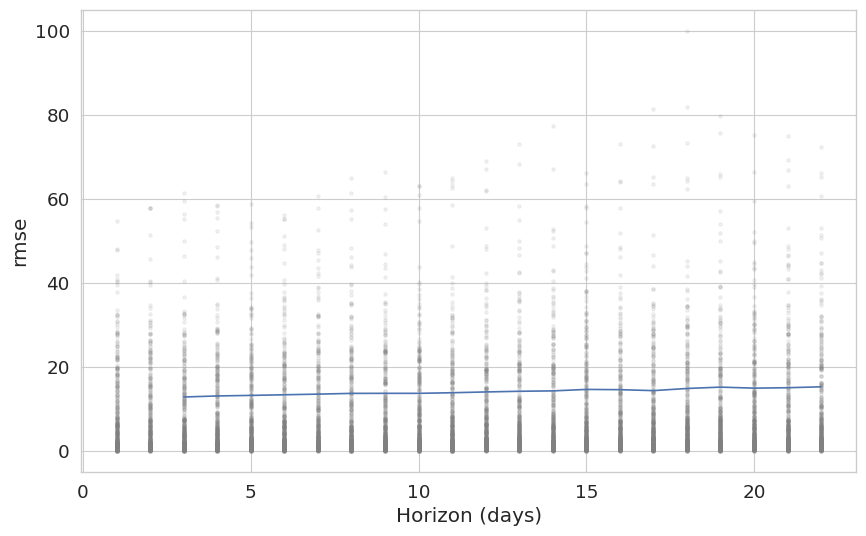

In [ ]:
fig = plot_cross_validation_metric(df_cv_1, metric='rmse')

In [ ]:
df_cv_1.head()

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1987-06-08,18.379624,17.599839,19.163715,19.94,1987-06-05
1,1987-06-09,18.227688,17.403554,19.055902,19.84,1987-06-05
2,1987-06-10,18.164692,17.426200,18.908653,19.83,1987-06-05
3,1987-06-11,18.171204,17.412992,18.951941,19.85,1987-06-05
4,1987-06-12,18.212181,17.426888,18.956949,19.93,1987-06-05


(array([ 5113.,  6574.,  8035.,  9496., 10957., 12418., 13879., 15340.,
        16801., 18262., 19723.]),
 [Text(5113.0, 0, '1984'),
  Text(6574.0, 0, '1988'),
  Text(8035.0, 0, '1992'),
  Text(9496.0, 0, '1996'),
  Text(10957.0, 0, '2000'),
  Text(12418.0, 0, '2004'),
  Text(13879.0, 0, '2008'),
  Text(15340.0, 0, '2012'),
  Text(16801.0, 0, '2016'),
  Text(18262.0, 0, '2020'),
  Text(19723.0, 0, '2024')])

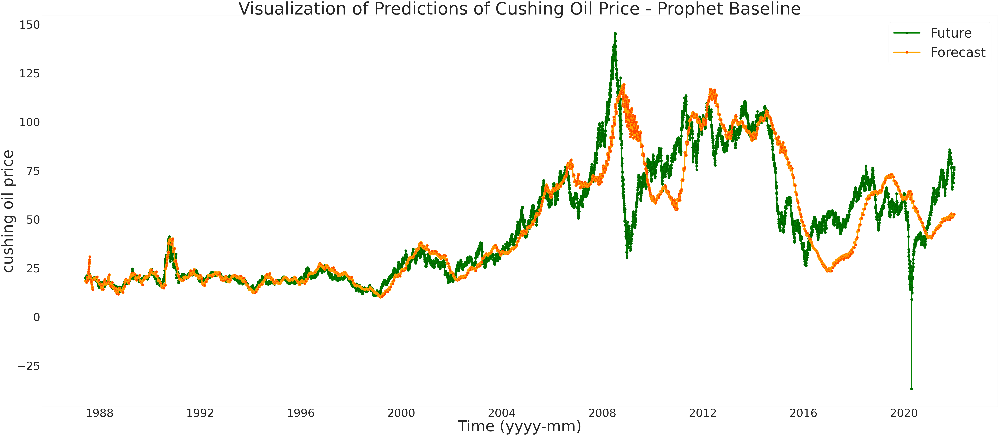

In [ ]:
# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(df_cv_1['ds'],df_cv_1['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(df_cv_1['ds'],df_cv_1['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


# plt.fill_between(df_cv['ds'], df_cv['yhat_lower'], df_cv['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('cushing oil price', fontsize= 75)
plt.title('Visualization of Predictions of Cushing Oil Price - Prophet Baseline', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)
# plt.savefig('forecast_future.png')

In [ ]:
cushing_y_forecast_prophet_baseline = m1.predict(cushing_y_future)
cushing_y_forecast_prophet_baseline[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].head()

,ds,yhat,yhat_lower,yhat_upper
0,2022-01-03,53.870790,43.326485,64.126903
1,2022-01-04,53.909395,44.114430,64.810165
2,2022-01-05,53.924859,43.492020,64.363220
3,2022-01-06,53.982159,43.915198,64.309785
4,2022-01-07,53.851647,43.204997,64.490678


In [ ]:
performance_metrics(df_cv_1)

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,3 days,164.806779,12.837709,8.005292,0.164439,0.103569,0.156875,0.457398
1,4 days,171.226079,13.085338,8.116165,0.171357,0.102158,0.160800,0.443746
2,5 days,174.595121,13.213445,8.223934,0.174931,0.106642,0.164122,0.430650
3,6 days,178.659814,13.366369,8.375119,0.176762,0.102070,0.166702,0.423148
4,7 days,182.744684,13.518309,8.410505,0.174938,0.108473,0.164591,0.430973
5,8 days,187.600566,13.696736,8.441550,0.172134,0.105801,0.163114,0.432314
6,9 days,187.896019,13.707517,8.492767,0.171194,0.107951,0.164284,0.417268
7,10 days,187.852282,13.705921,8.611689,0.174325,0.117143,0.168098,0.379632
8,11 days,191.845280,13.850822,8.698824,0.179480,0.116657,0.171985,0.374874
9,12 days,197.064582,14.037969,8.765466,0.184776,0.121158,0.174898,0.390295


In [ ]:
performance_metrics(df_cv_1).to_csv('/content/drive/MyDrive/PCDS_OilPricePrediction/forecasting_products/Prophet/Cushing/Metrics_BasicModel.csv')

(array([18993., 19052., 19113., 19174., 19236., 19297., 19358., 19417.]),
 [Text(18993.0, 0, '2022-01'),
  Text(19052.0, 0, '2022-03'),
  Text(19113.0, 0, '2022-05'),
  Text(19174.0, 0, '2022-07'),
  Text(19236.0, 0, '2022-09'),
  Text(19297.0, 0, '2022-11'),
  Text(19358.0, 0, '2023-01'),
  Text(19417.0, 0, '2023-03')])

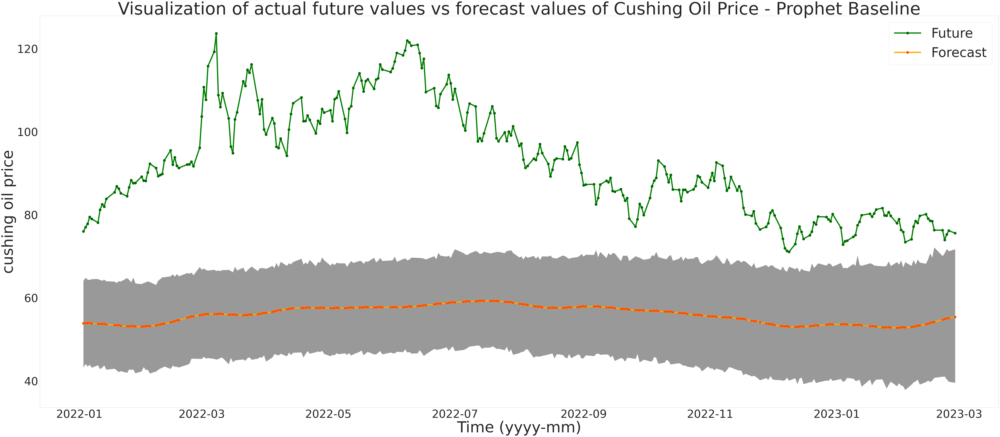

In [ ]:
# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(cushing_y_future['ds'],cushing_y_future['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(cushing_y_future['ds'],cushing_y_forecast_prophet_baseline['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


plt.fill_between(cushing_y_future['ds'], cushing_y_forecast_prophet_baseline['yhat_lower'], cushing_y_forecast_prophet_baseline['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('cushing oil price', fontsize= 75)
plt.title('Visualization of actual future values vs forecast values of Cushing Oil Price - Prophet Baseline', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)
# plt.savefig('forecast_future.png')

### 2) Model with covid time as unrepeated holiday

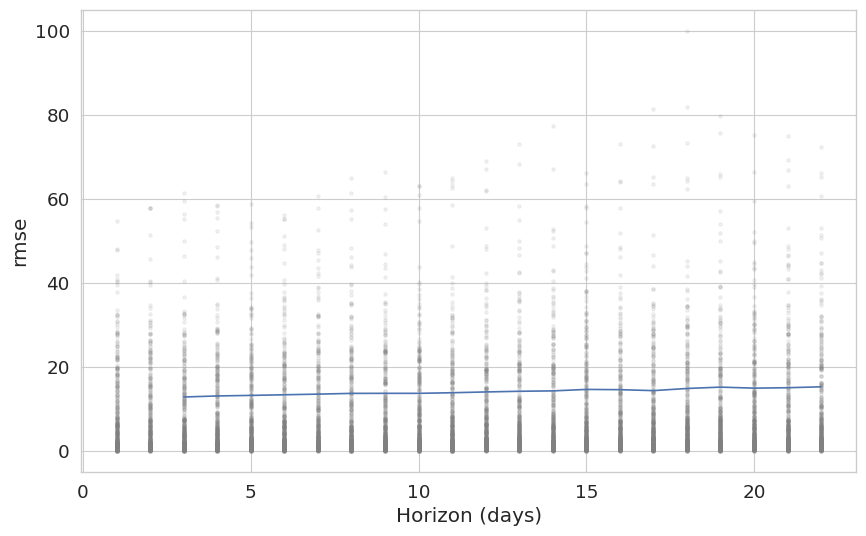

In [ ]:
# from prophet.plot import plot_cross_validation_metric
fig = plot_cross_validation_metric(df_cv_2, metric='rmse')

In [ ]:
df_cv_2.head()

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1987-06-08,18.379624,17.599839,19.163715,19.94,1987-06-05
1,1987-06-09,18.227688,17.403554,19.055902,19.84,1987-06-05
2,1987-06-10,18.164692,17.426200,18.908653,19.83,1987-06-05
3,1987-06-11,18.171204,17.412992,18.951941,19.85,1987-06-05
4,1987-06-12,18.212181,17.426888,18.956949,19.93,1987-06-05


(array([ 5113.,  6574.,  8035.,  9496., 10957., 12418., 13879., 15340.,
        16801., 18262., 19723.]),
 [Text(5113.0, 0, '1984'),
  Text(6574.0, 0, '1988'),
  Text(8035.0, 0, '1992'),
  Text(9496.0, 0, '1996'),
  Text(10957.0, 0, '2000'),
  Text(12418.0, 0, '2004'),
  Text(13879.0, 0, '2008'),
  Text(15340.0, 0, '2012'),
  Text(16801.0, 0, '2016'),
  Text(18262.0, 0, '2020'),
  Text(19723.0, 0, '2024')])

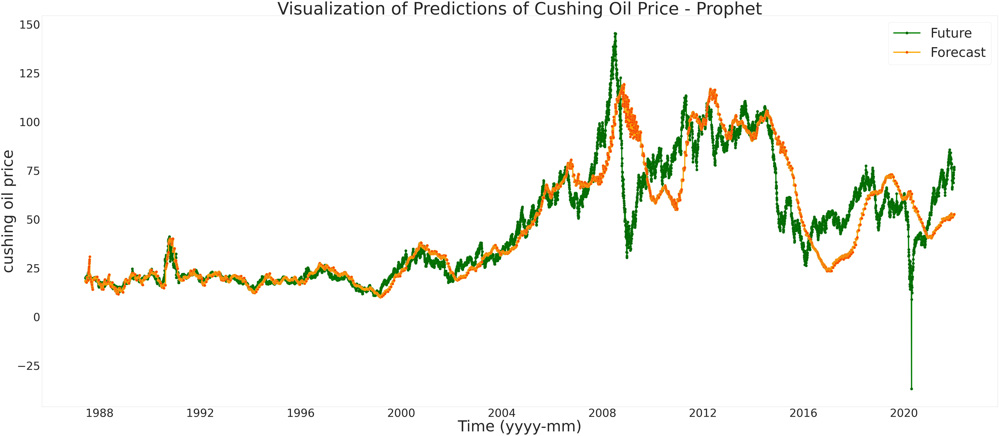

In [ ]:
# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(df_cv_2['ds'],df_cv_2['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(df_cv_2['ds'],df_cv_2['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


# plt.fill_between(df_cv['ds'], df_cv['yhat_lower'], df_cv['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('cushing oil price', fontsize= 75)
plt.title('Visualization of Predictions of Cushing Oil Price - Prophet', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)
# plt.savefig('forecast_future.png')

In [ ]:
cushing_y_forecast_prophet = m2.predict(cushing_y_future)
cushing_y_forecast_prophet[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].head()

,ds,yhat,yhat_lower,yhat_upper
0,2022-01-03,59.493602,49.324796,69.556553
1,2022-01-04,59.479162,49.502129,68.625989
2,2022-01-05,59.484319,49.361500,69.664211
3,2022-01-06,59.646958,49.794800,70.198694
4,2022-01-07,59.522212,49.442610,69.221645


In [ ]:
performance_metrics(df_cv_2)

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,3 days,164.806779,12.837709,8.005292,0.164439,0.103569,0.156875,0.459210
1,4 days,171.226079,13.085338,8.116165,0.171357,0.102158,0.160800,0.450395
2,5 days,174.595121,13.213445,8.223934,0.174931,0.106642,0.164122,0.439421
3,6 days,178.659814,13.366369,8.375119,0.176762,0.102070,0.166702,0.430761
4,7 days,182.744684,13.518309,8.410505,0.174938,0.108473,0.164591,0.433000
5,8 days,187.600566,13.696736,8.441550,0.172134,0.105801,0.163114,0.428139
6,9 days,187.896019,13.707517,8.492767,0.171194,0.107951,0.164284,0.415901
7,10 days,187.852282,13.705921,8.611689,0.174325,0.117143,0.168098,0.386986
8,11 days,191.845280,13.850822,8.698824,0.179480,0.116657,0.171985,0.381067
9,12 days,197.064582,14.037969,8.765466,0.184776,0.121158,0.174898,0.394827


In [ ]:
performance_metrics(df_cv_2).to_csv('/content/drive/MyDrive/PCDS_OilPricePrediction/forecasting_products/Prophet/Cushing/Metrics_CovidUnrepeatedHoliday.csv')

(array([18993., 19052., 19113., 19174., 19236., 19297., 19358., 19417.]),
 [Text(18993.0, 0, '2022-01'),
  Text(19052.0, 0, '2022-03'),
  Text(19113.0, 0, '2022-05'),
  Text(19174.0, 0, '2022-07'),
  Text(19236.0, 0, '2022-09'),
  Text(19297.0, 0, '2022-11'),
  Text(19358.0, 0, '2023-01'),
  Text(19417.0, 0, '2023-03')])

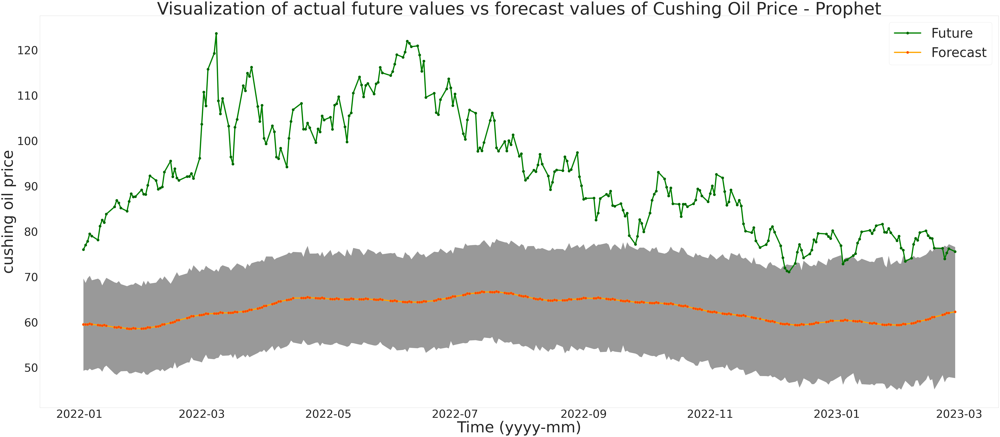

In [ ]:
# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(cushing_y_future['ds'],cushing_y_future['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(cushing_y_future['ds'],cushing_y_forecast_prophet['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


plt.fill_between(cushing_y_future['ds'], cushing_y_forecast_prophet['yhat_lower'], cushing_y_forecast_prophet['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('cushing oil price', fontsize= 75)
plt.title('Visualization of actual future values vs forecast values of Cushing Oil Price - Prophet', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)
# plt.savefig('forecast_future.png')

### 3) Model with covid time as repeated holiday and yearly seasonality

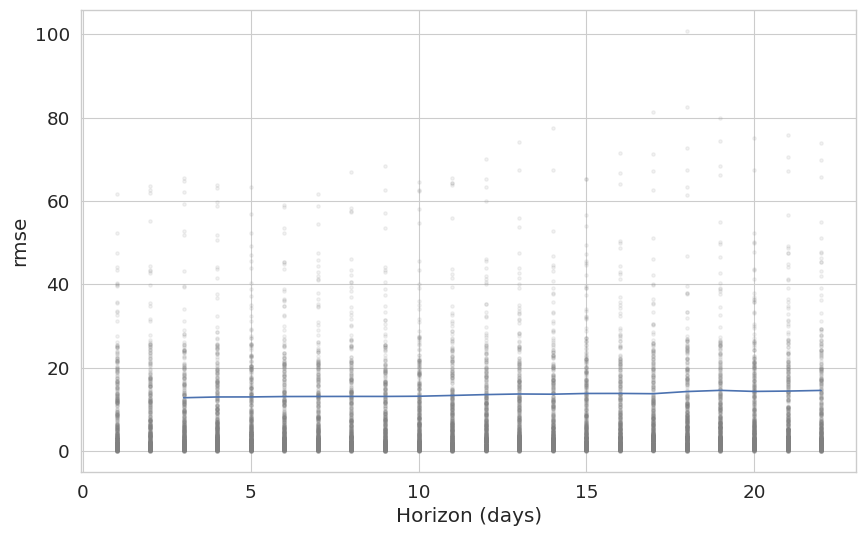

In [ ]:
# from prophet.plot import plot_cross_validation_metric
fig = plot_cross_validation_metric(df_cv_3, metric='rmse')

In [ ]:
df_cv_3.head()

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1987-06-08,18.607948,17.453824,19.768446,19.94,1987-06-05
1,1987-06-09,18.510488,17.290439,19.736291,19.84,1987-06-05
2,1987-06-10,18.351420,17.237951,19.452524,19.83,1987-06-05
3,1987-06-11,18.348834,17.225987,19.505649,19.85,1987-06-05
4,1987-06-12,18.231363,17.086095,19.315234,19.93,1987-06-05


(array([ 5113.,  6574.,  8035.,  9496., 10957., 12418., 13879., 15340.,
        16801., 18262., 19723.]),
 [Text(5113.0, 0, '1984'),
  Text(6574.0, 0, '1988'),
  Text(8035.0, 0, '1992'),
  Text(9496.0, 0, '1996'),
  Text(10957.0, 0, '2000'),
  Text(12418.0, 0, '2004'),
  Text(13879.0, 0, '2008'),
  Text(15340.0, 0, '2012'),
  Text(16801.0, 0, '2016'),
  Text(18262.0, 0, '2020'),
  Text(19723.0, 0, '2024')])

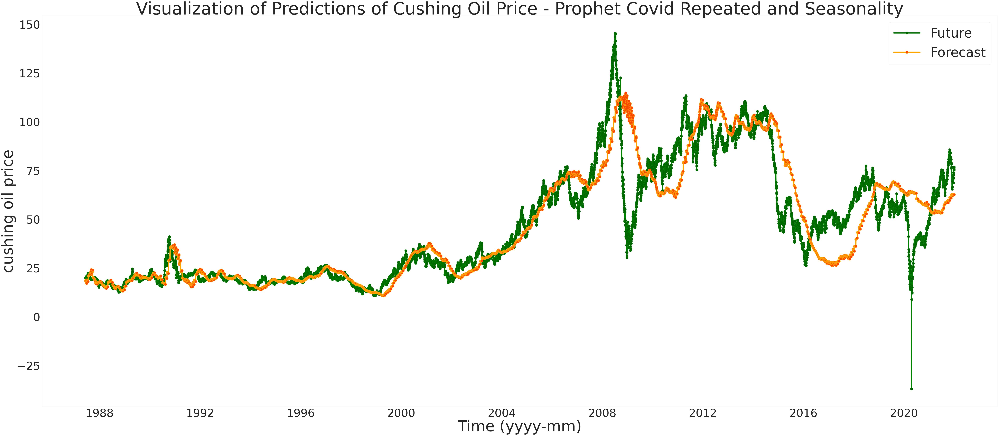

In [ ]:
# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(df_cv_3['ds'],df_cv_3['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(df_cv_3['ds'],df_cv_3['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


# plt.fill_between(df_cv['ds'], df_cv['yhat_lower'], df_cv['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('cushing oil price', fontsize= 75)
plt.title('Visualization of Predictions of Cushing Oil Price - Prophet Covid Repeated and Seasonality', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)
# plt.savefig('forecast_future.png')

In [ ]:
cushing_y_forecast_prophet_seasonality = m3.predict(cushing_y_future)
cushing_y_forecast_prophet_seasonality[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].head()

,ds,yhat,yhat_lower,yhat_upper
0,2022-01-03,63.425669,52.758685,74.767184
1,2022-01-04,63.522656,52.910391,74.021089
2,2022-01-05,63.445258,53.279325,73.793451
3,2022-01-06,63.521670,53.064281,74.476473
4,2022-01-07,63.408964,52.665585,73.982783


In [ ]:
performance_metrics(df_cv_3)

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,3 days,162.979337,12.766336,7.988245,0.173690,0.118715,0.162224,0.492689
1,4 days,167.660615,12.948383,8.126456,0.181686,0.121826,0.167088,0.469814
2,5 days,167.931795,12.958850,8.221001,0.184986,0.127390,0.170445,0.456136
3,6 days,170.401706,13.053800,8.364951,0.186940,0.126739,0.173383,0.442724
4,7 days,170.795439,13.068873,8.331467,0.184263,0.122217,0.170625,0.452418
5,8 days,171.177411,13.083479,8.247225,0.178303,0.118364,0.166446,0.470619
6,9 days,171.044980,13.078417,8.245886,0.174863,0.117459,0.165400,0.478875
7,10 days,172.282927,13.125659,8.357852,0.176925,0.125368,0.167909,0.468911
8,11 days,177.239293,13.313125,8.529907,0.184178,0.132185,0.173748,0.452145
9,12 days,182.823777,13.521234,8.698362,0.192119,0.141836,0.179294,0.439611


In [ ]:
performance_metrics(df_cv_3).to_csv('/content/drive/MyDrive/PCDS_OilPricePrediction/forecasting_products/Prophet/Cushing/Metrics_RepeatedHolidayYearlySeasonality.csv')

(array([18993., 19052., 19113., 19174., 19236., 19297., 19358., 19417.]),
 [Text(18993.0, 0, '2022-01'),
  Text(19052.0, 0, '2022-03'),
  Text(19113.0, 0, '2022-05'),
  Text(19174.0, 0, '2022-07'),
  Text(19236.0, 0, '2022-09'),
  Text(19297.0, 0, '2022-11'),
  Text(19358.0, 0, '2023-01'),
  Text(19417.0, 0, '2023-03')])

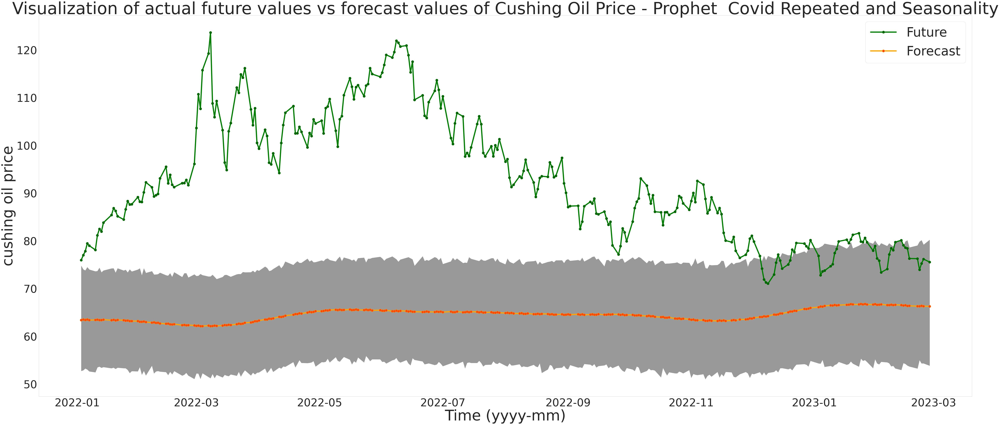

In [ ]:
# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(cushing_y_future['ds'],cushing_y_future['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(cushing_y_future['ds'],cushing_y_forecast_prophet_seasonality['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


plt.fill_between(cushing_y_future['ds'], cushing_y_forecast_prophet_seasonality['yhat_lower'], cushing_y_forecast_prophet_seasonality['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('cushing oil price', fontsize= 75)
plt.title('Visualization of actual future values vs forecast values of Cushing Oil Price - Prophet  Covid Repeated and Seasonality', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)
# plt.savefig('forecast_future.png')

### 3A) Model with covid time as repeated holiday and yearly seasonality, Logistic Growth

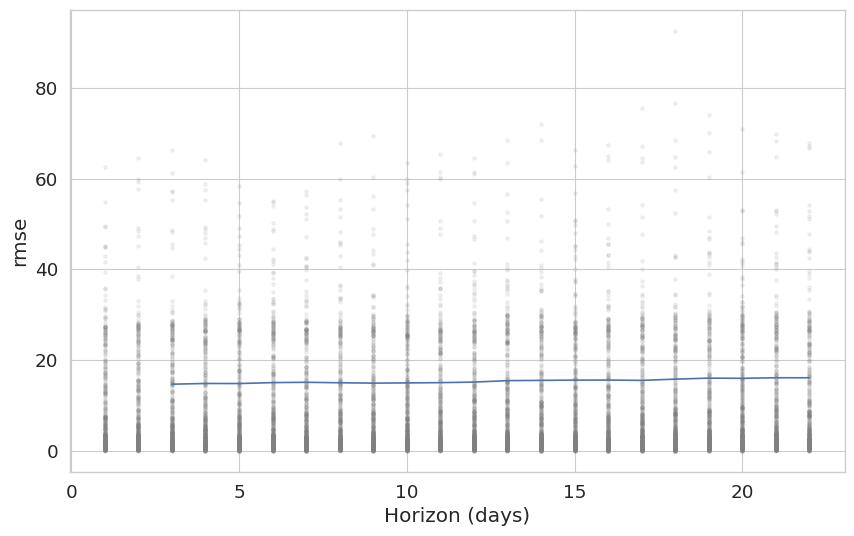

In [ ]:
# from prophet.plot import plot_cross_validation_metric
fig = plot_cross_validation_metric(df_cv_3a, metric='rmse')

In [ ]:
df_cv_3a.head()

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1987-06-08,18.771257,17.279581,20.271947,19.94,1987-06-05
1,1987-06-09,18.643337,17.062353,20.228479,19.84,1987-06-05
2,1987-06-10,18.446849,17.005421,19.870767,19.83,1987-06-05
3,1987-06-11,18.479841,17.026524,19.972651,19.85,1987-06-05
4,1987-06-12,18.319258,16.848677,19.723168,19.93,1987-06-05


(array([ 5113.,  6574.,  8035.,  9496., 10957., 12418., 13879., 15340.,
        16801., 18262., 19723.]),
 [Text(5113.0, 0, '1984'),
  Text(6574.0, 0, '1988'),
  Text(8035.0, 0, '1992'),
  Text(9496.0, 0, '1996'),
  Text(10957.0, 0, '2000'),
  Text(12418.0, 0, '2004'),
  Text(13879.0, 0, '2008'),
  Text(15340.0, 0, '2012'),
  Text(16801.0, 0, '2016'),
  Text(18262.0, 0, '2020'),
  Text(19723.0, 0, '2024')])

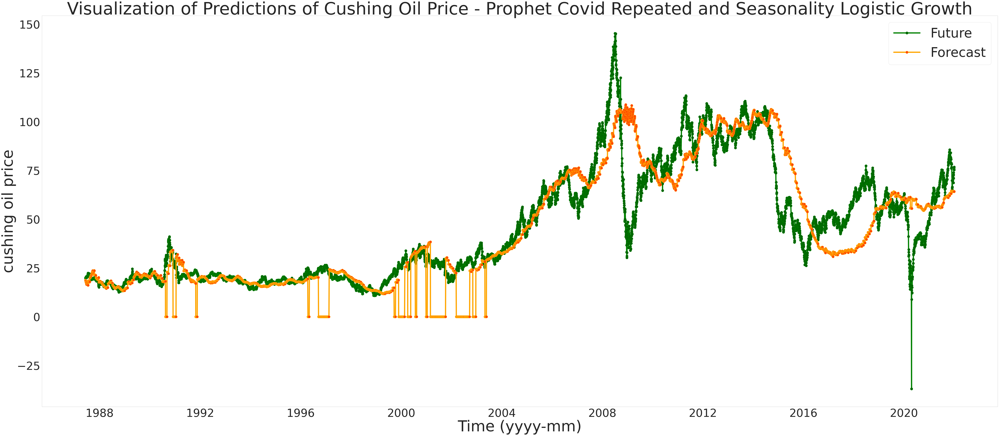

In [ ]:
# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(df_cv_3a['ds'],df_cv_3a['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(df_cv_3a['ds'],df_cv_3a['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


# plt.fill_between(df_cv['ds'], df_cv['yhat_lower'], df_cv['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('cushing oil price', fontsize= 75)
plt.title('Visualization of Predictions of Cushing Oil Price - Prophet Covid Repeated and Seasonality Logistic Growth', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)
# plt.savefig('forecast_future.png')

In [ ]:
cushing_y_forecast_prophet_seasonality_logisticGrowth = m3a.predict(cushing_y_future)
cushing_y_forecast_prophet_seasonality_logisticGrowth[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].head()

,ds,yhat,yhat_lower,yhat_upper
0,2022-01-03,64.758404,51.009016,78.157820
1,2022-01-04,64.812553,51.244139,78.434886
2,2022-01-05,64.694580,50.512834,77.898735
3,2022-01-06,64.842448,52.302624,77.814878
4,2022-01-07,64.667040,51.164708,78.653580


In [ ]:
performance_metrics(df_cv_3a)

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,3 days,216.287007,14.706699,9.528954,0.238147,0.120851,0.298640,0.576506
1,4 days,220.962375,14.864803,9.668425,0.245871,0.122508,0.304448,0.566342
2,5 days,220.597692,14.852531,9.725100,0.247755,0.122352,0.305389,0.571646
3,6 days,226.598646,15.053194,9.941136,0.253194,0.122508,0.316441,0.566336
4,7 days,228.891094,15.129147,9.972890,0.253045,0.125114,0.319174,0.577772
5,8 days,225.638982,15.021284,9.799835,0.243916,0.122425,0.306578,0.597015
6,9 days,223.343038,14.944666,9.747201,0.238339,0.125719,0.299960,0.591963
7,10 days,224.609450,14.986976,9.847742,0.240551,0.128965,0.304287,0.570056
8,11 days,226.409890,15.046923,9.923040,0.244657,0.136772,0.305102,0.558327
9,12 days,230.211241,15.172714,10.047709,0.249798,0.143147,0.306015,0.552787


In [ ]:
performance_metrics(df_cv_3a).to_csv('/content/drive/MyDrive/PCDS_OilPricePrediction/forecasting_products/Prophet/Cushing/Metrics_BasicModel_LogisticGrowth.csv')

(array([18993., 19052., 19113., 19174., 19236., 19297., 19358., 19417.]),
 [Text(18993.0, 0, '2022-01'),
  Text(19052.0, 0, '2022-03'),
  Text(19113.0, 0, '2022-05'),
  Text(19174.0, 0, '2022-07'),
  Text(19236.0, 0, '2022-09'),
  Text(19297.0, 0, '2022-11'),
  Text(19358.0, 0, '2023-01'),
  Text(19417.0, 0, '2023-03')])

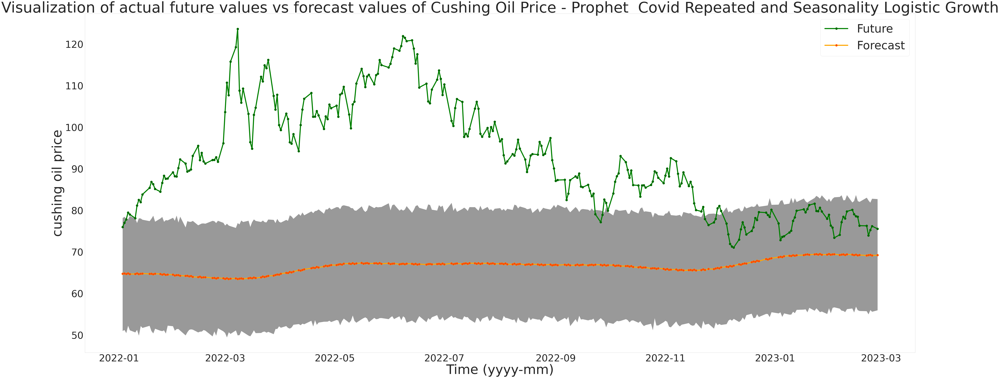

In [ ]:
# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(cushing_y_future['ds'],cushing_y_future['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(cushing_y_future['ds'],cushing_y_forecast_prophet_seasonality_logisticGrowth['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


plt.fill_between(cushing_y_future['ds'], cushing_y_forecast_prophet_seasonality_logisticGrowth['yhat_lower'], cushing_y_forecast_prophet_seasonality_logisticGrowth['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('cushing oil price', fontsize= 75)
plt.title('Visualization of actual future values vs forecast values of Cushing Oil Price - Prophet  Covid Repeated and Seasonality Logistic Growth', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)
# plt.savefig('forecast_future.png')

### 5) Basic Model 22 day CV

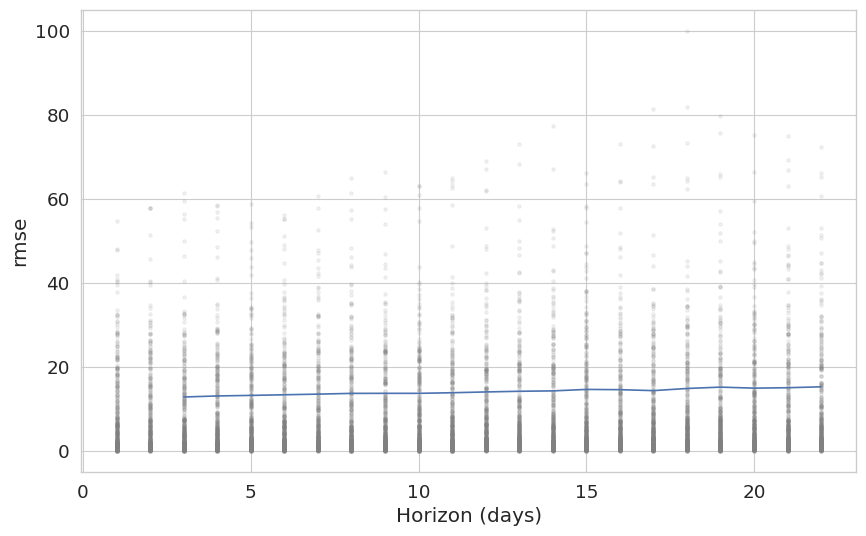

In [ ]:
fig = plot_cross_validation_metric(df_cv_5, metric='rmse')

In [ ]:
df_cv_5.head()

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1987-06-08,18.379624,17.621336,19.161714,19.94,1987-06-05
1,1987-06-09,18.227688,17.414237,18.929881,19.84,1987-06-05
2,1987-06-10,18.164692,17.376248,18.894631,19.83,1987-06-05
3,1987-06-11,18.171204,17.424528,18.979382,19.85,1987-06-05
4,1987-06-12,18.212181,17.400696,19.010480,19.93,1987-06-05


(array([ 5113.,  6574.,  8035.,  9496., 10957., 12418., 13879., 15340.,
        16801., 18262., 19723.]),
 [Text(5113.0, 0, '1984'),
  Text(6574.0, 0, '1988'),
  Text(8035.0, 0, '1992'),
  Text(9496.0, 0, '1996'),
  Text(10957.0, 0, '2000'),
  Text(12418.0, 0, '2004'),
  Text(13879.0, 0, '2008'),
  Text(15340.0, 0, '2012'),
  Text(16801.0, 0, '2016'),
  Text(18262.0, 0, '2020'),
  Text(19723.0, 0, '2024')])

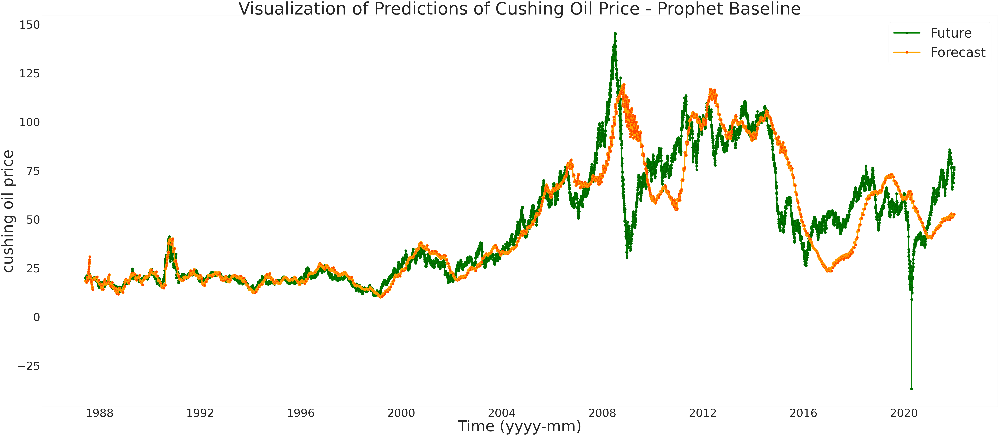

In [ ]:
# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(df_cv_5['ds'],df_cv_5['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(df_cv_5['ds'],df_cv_5['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


# plt.fill_between(df_cv['ds'], df_cv['yhat_lower'], df_cv['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('cushing oil price', fontsize= 75)
plt.title('Visualization of Predictions of Cushing Oil Price - Prophet Baseline 22 day Horizon', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)

In [ ]:
cushing_y_forecast_prophet_baseline = m5.predict(cushing_y_future)
cushing_y_forecast_prophet_baseline[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].head()

,ds,yhat,yhat_lower,yhat_upper
0,2022-01-03,53.870790,42.793216,64.278613
1,2022-01-04,53.909395,41.698802,64.593134
2,2022-01-05,53.924859,42.966478,64.161989
3,2022-01-06,53.982159,43.749158,64.426575
4,2022-01-07,53.851647,43.671516,64.275962


In [ ]:
performance_metrics(df_cv_5)

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,3 days,164.806779,12.837709,8.005292,0.164439,0.103569,0.156875,0.458788
1,4 days,171.226079,13.085338,8.116165,0.171357,0.102158,0.160800,0.447621
2,5 days,174.595121,13.213445,8.223934,0.174931,0.106642,0.164122,0.436222
3,6 days,178.659814,13.366369,8.375119,0.176762,0.102070,0.166702,0.427741
4,7 days,182.744684,13.518309,8.410505,0.174938,0.108473,0.164591,0.430704
5,8 days,187.600566,13.696736,8.441550,0.172134,0.105801,0.163114,0.425425
6,9 days,187.896019,13.707517,8.492767,0.171194,0.107951,0.164284,0.410161
7,10 days,187.852282,13.705921,8.611689,0.174325,0.117143,0.168098,0.380791
8,11 days,191.845280,13.850822,8.698824,0.179480,0.116657,0.171985,0.379240
9,12 days,197.064582,14.037969,8.765466,0.184776,0.121158,0.174898,0.388651


(array([18993., 19052., 19113., 19174., 19236., 19297., 19358., 19417.]),
 [Text(18993.0, 0, '2022-01'),
  Text(19052.0, 0, '2022-03'),
  Text(19113.0, 0, '2022-05'),
  Text(19174.0, 0, '2022-07'),
  Text(19236.0, 0, '2022-09'),
  Text(19297.0, 0, '2022-11'),
  Text(19358.0, 0, '2023-01'),
  Text(19417.0, 0, '2023-03')])

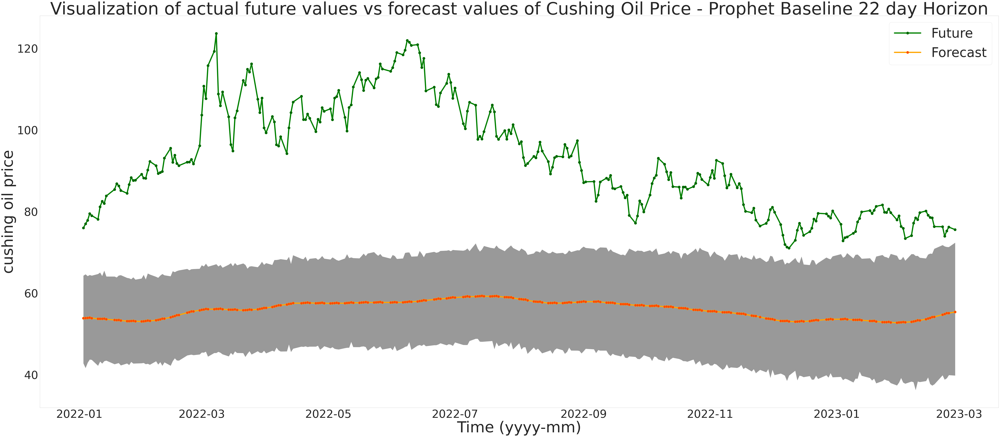

In [ ]:

# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(cushing_y_future['ds'],cushing_y_future['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(cushing_y_future['ds'],cushing_y_forecast_prophet_baseline['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


plt.fill_between(cushing_y_future['ds'], cushing_y_forecast_prophet_baseline['yhat_lower'], cushing_y_forecast_prophet_baseline['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('cushing oil price', fontsize= 75)
plt.title('Visualization of actual future values vs forecast values of Cushing Oil Price - Prophet Baseline 22 day Horizon', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)

## Brent Data

### 1) Basic Model

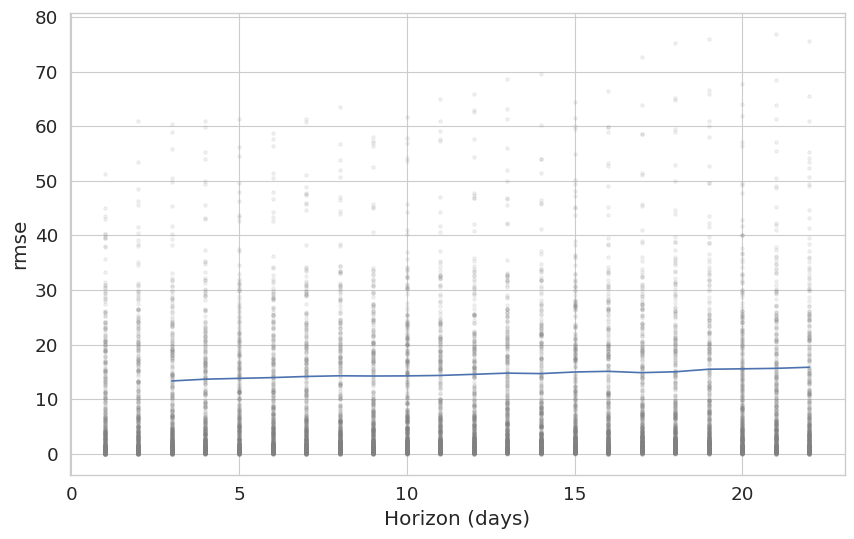

In [ ]:
fig = plot_cross_validation_metric(df_brent_cv_1, metric='rmse')

In [ ]:
df_brent_cv_1.head()

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1988-10-24,12.376696,11.884986,12.911295,12.20,1988-10-23
1,1988-10-25,12.269794,11.747220,12.779185,12.08,1988-10-23
2,1988-10-26,12.216097,11.690797,12.726043,12.08,1988-10-23
3,1988-10-27,12.129551,11.575786,12.641390,12.33,1988-10-23
4,1988-10-28,12.034519,11.493870,12.552921,12.60,1988-10-23


(array([ 5113.,  6574.,  8035.,  9496., 10957., 12418., 13879., 15340.,
        16801., 18262., 19723.]),
 [Text(5113.0, 0, '1984'),
  Text(6574.0, 0, '1988'),
  Text(8035.0, 0, '1992'),
  Text(9496.0, 0, '1996'),
  Text(10957.0, 0, '2000'),
  Text(12418.0, 0, '2004'),
  Text(13879.0, 0, '2008'),
  Text(15340.0, 0, '2012'),
  Text(16801.0, 0, '2016'),
  Text(18262.0, 0, '2020'),
  Text(19723.0, 0, '2024')])

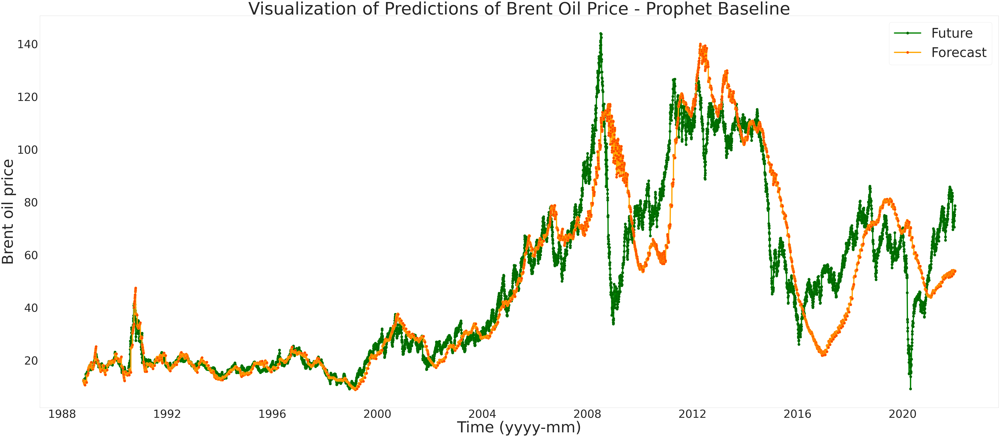

In [ ]:
# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(df_brent_cv_1['ds'],df_brent_cv_1['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(df_brent_cv_1['ds'],df_brent_cv_1['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


# plt.fill_between(df_cv['ds'], df_cv['yhat_lower'], df_cv['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('Brent oil price', fontsize= 75)
plt.title('Visualization of Predictions of Brent Oil Price - Prophet Baseline', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)
# plt.savefig('forecast_future.png')

In [ ]:
brent_y_forecast_prophet_baseline = m1_brent.predict(brent_y_future)
brent_y_forecast_prophet_baseline[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].head()

,ds,yhat,yhat_lower,yhat_upper
0,2022-01-03,55.345896,44.174059,66.750323
1,2022-01-04,55.264723,43.909474,66.879549
2,2022-01-05,55.309803,43.798801,66.146433
3,2022-01-06,55.526078,44.823072,66.853508
4,2022-01-07,55.314585,45.185768,66.215116


In [ ]:
performance_metrics(df_brent_cv_1)

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,3 days,178.483458,13.359770,8.335648,0.160486,0.095141,0.154574,0.452993
1,4 days,187.245756,13.683777,8.491381,0.169279,0.092026,0.159675,0.445710
2,5 days,191.321054,13.831885,8.616394,0.174747,0.102962,0.164162,0.439930
3,6 days,195.297099,13.974874,8.797224,0.178420,0.107805,0.168060,0.422480
4,7 days,201.116932,14.181570,8.931699,0.179651,0.108589,0.168380,0.417299
5,8 days,204.634841,14.305063,8.951766,0.175428,0.108726,0.166388,0.426353
6,9 days,203.410655,14.262211,8.960761,0.171566,0.104002,0.166351,0.414570
7,10 days,204.072936,14.285410,9.051577,0.173343,0.114734,0.168867,0.398939
8,11 days,206.507336,14.370363,9.048048,0.175435,0.115238,0.170364,0.400584
9,12 days,212.419362,14.574614,9.109904,0.180409,0.113653,0.172764,0.402242


In [ ]:
performance_metrics(df_brent_cv_1).to_csv('/content/drive/MyDrive/PCDS_OilPricePrediction/forecasting_products/Prophet/Brent/Metrics_BasicModel.csv')

(array([18993., 19052., 19113., 19174., 19236., 19297., 19358., 19417.]),
 [Text(18993.0, 0, '2022-01'),
  Text(19052.0, 0, '2022-03'),
  Text(19113.0, 0, '2022-05'),
  Text(19174.0, 0, '2022-07'),
  Text(19236.0, 0, '2022-09'),
  Text(19297.0, 0, '2022-11'),
  Text(19358.0, 0, '2023-01'),
  Text(19417.0, 0, '2023-03')])

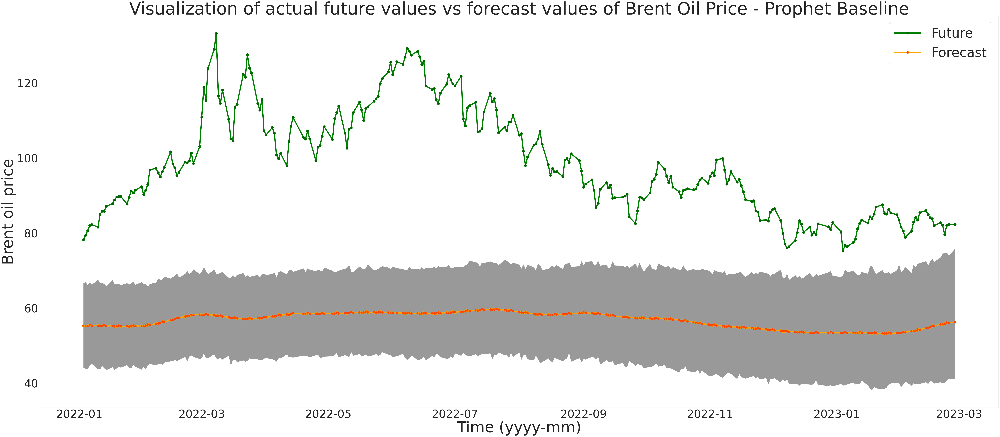

In [ ]:
# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(brent_y_future['ds'],brent_y_future['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(brent_y_future['ds'],brent_y_forecast_prophet_baseline['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


plt.fill_between(brent_y_future['ds'], brent_y_forecast_prophet_baseline['yhat_lower'], brent_y_forecast_prophet_baseline['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('Brent oil price', fontsize= 75)
plt.title('Visualization of actual future values vs forecast values of Brent Oil Price - Prophet Baseline', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)
# plt.savefig('forecast_future.png')

### 2) Model with covid time as unrepeated holiday

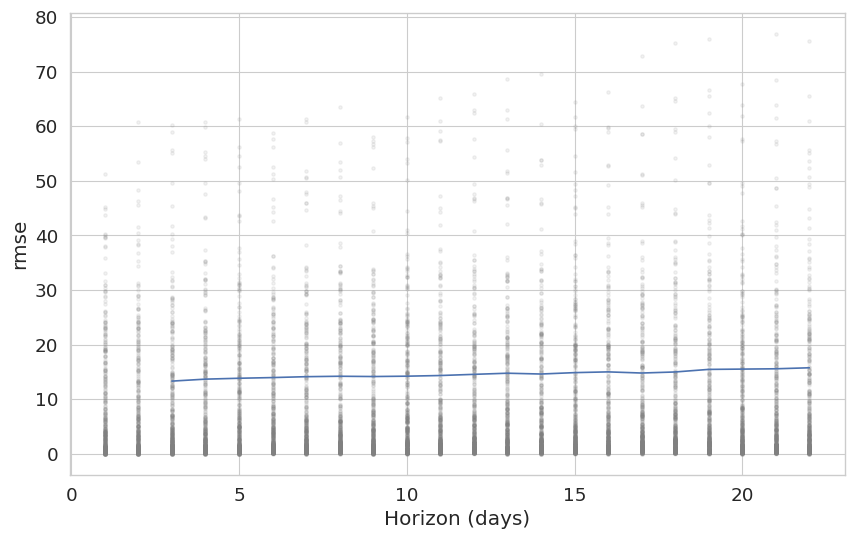

In [ ]:
fig = plot_cross_validation_metric(df_brent_cv_2, metric='rmse')

In [ ]:
df_brent_cv_2.head()

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1988-10-24,12.418987,11.919398,12.962155,12.20,1988-10-23
1,1988-10-25,12.314461,11.783512,12.831006,12.08,1988-10-23
2,1988-10-26,12.263175,11.729456,12.781294,12.08,1988-10-23
3,1988-10-27,12.179129,11.616489,12.699172,12.33,1988-10-23
4,1988-10-28,12.086582,11.537268,12.613292,12.60,1988-10-23


(array([ 5113.,  6574.,  8035.,  9496., 10957., 12418., 13879., 15340.,
        16801., 18262., 19723.]),
 [Text(5113.0, 0, '1984'),
  Text(6574.0, 0, '1988'),
  Text(8035.0, 0, '1992'),
  Text(9496.0, 0, '1996'),
  Text(10957.0, 0, '2000'),
  Text(12418.0, 0, '2004'),
  Text(13879.0, 0, '2008'),
  Text(15340.0, 0, '2012'),
  Text(16801.0, 0, '2016'),
  Text(18262.0, 0, '2020'),
  Text(19723.0, 0, '2024')])

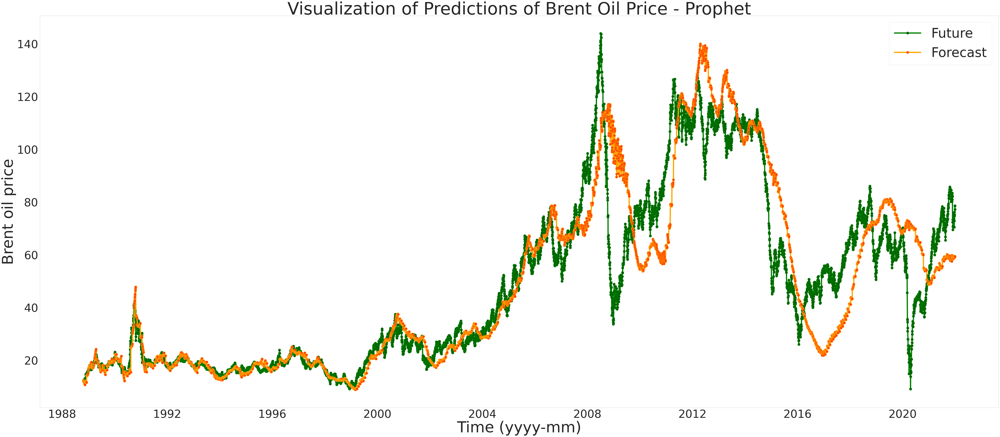

In [ ]:
# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(df_brent_cv_2['ds'],df_brent_cv_2['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(df_brent_cv_2['ds'],df_brent_cv_2['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


# plt.fill_between(df_cv['ds'], df_cv['yhat_lower'], df_cv['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('Brent oil price', fontsize= 75)
plt.title('Visualization of Predictions of Brent Oil Price - Prophet', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)
# plt.savefig('forecast_future.png')

In [ ]:
brent_y_forecast_prophet = m2_brent.predict(brent_y_future)
brent_y_forecast_prophet[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].head()

,ds,yhat,yhat_lower,yhat_upper
0,2022-01-03,60.832578,51.866844,71.088207
1,2022-01-04,60.778208,50.428430,71.027068
2,2022-01-05,60.820899,50.768644,71.992156
3,2022-01-06,61.077903,50.748362,70.334557
4,2022-01-07,60.845569,50.315916,70.781547


In [ ]:
performance_metrics(df_brent_cv_2)

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,3 days,177.614798,13.327220,8.281418,0.161138,0.094415,0.152957,0.454411
1,4 days,187.362464,13.688041,8.449388,0.170543,0.090553,0.158251,0.443602
2,5 days,191.814561,13.849713,8.576227,0.176215,0.100764,0.162772,0.428130
3,6 days,195.323156,13.975806,8.750819,0.179696,0.106283,0.166615,0.413773
4,7 days,199.869687,14.137528,8.866109,0.180542,0.106655,0.166734,0.413680
5,8 days,202.112738,14.216636,8.871898,0.175908,0.106263,0.164650,0.424934
6,9 days,200.649387,14.165076,8.882962,0.171656,0.104308,0.164597,0.415531
7,10 days,202.478910,14.229508,8.988377,0.173708,0.111613,0.167190,0.401314
8,11 days,205.951052,14.350995,8.992193,0.176172,0.113131,0.168740,0.402000
9,12 days,212.123236,14.564451,9.058141,0.181338,0.113140,0.171210,0.400098


In [ ]:
performance_metrics(df_brent_cv_2).to_csv('/content/drive/MyDrive/PCDS_OilPricePrediction/forecasting_products/Prophet/Brent/Metrics_CovidUnrepeatedHoliday_Model.csv')

(array([18993., 19052., 19113., 19174., 19236., 19297., 19358., 19417.]),
 [Text(18993.0, 0, '2022-01'),
  Text(19052.0, 0, '2022-03'),
  Text(19113.0, 0, '2022-05'),
  Text(19174.0, 0, '2022-07'),
  Text(19236.0, 0, '2022-09'),
  Text(19297.0, 0, '2022-11'),
  Text(19358.0, 0, '2023-01'),
  Text(19417.0, 0, '2023-03')])

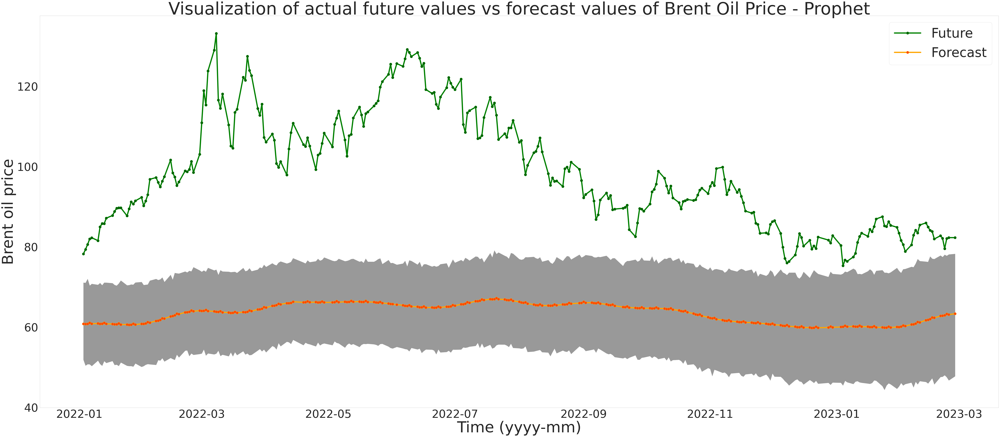

In [ ]:
# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(brent_y_future['ds'],brent_y_future['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(brent_y_future['ds'],brent_y_forecast_prophet['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


plt.fill_between(brent_y_future['ds'], brent_y_forecast_prophet['yhat_lower'], brent_y_forecast_prophet['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('Brent oil price', fontsize= 75)
plt.title('Visualization of actual future values vs forecast values of Brent Oil Price - Prophet', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)
# plt.savefig('forecast_future.png')

### 3) Model with covid time as repeated holiday and yearly seasonality

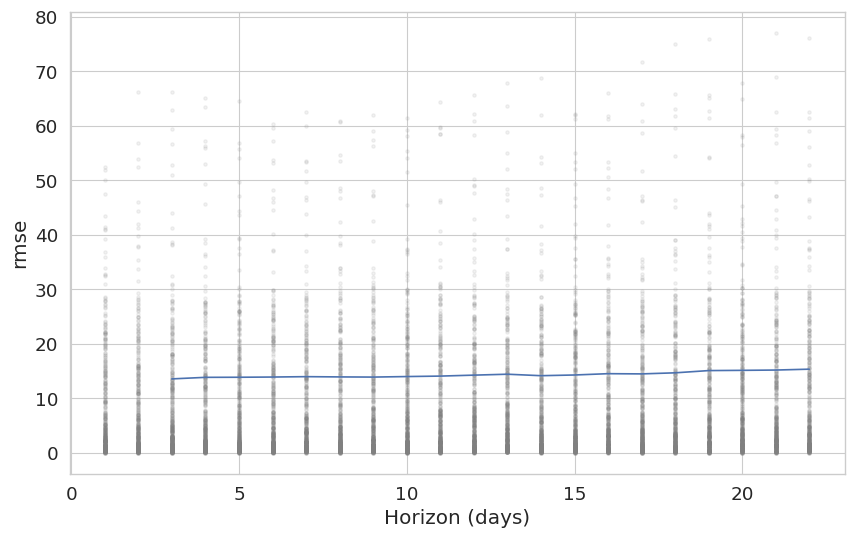

In [ ]:
# from prophet.plot import plot_cross_validation_metric
fig = plot_cross_validation_metric(df_brent_cv_3, metric='rmse')

In [ ]:
df_brent_cv_3.head()

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1988-10-24,12.161105,11.374753,13.016048,12.20,1988-10-23
1,1988-10-25,12.168488,11.332776,12.980139,12.08,1988-10-23
2,1988-10-26,12.117059,11.276988,12.932417,12.08,1988-10-23
3,1988-10-27,12.066858,11.180461,12.878513,12.33,1988-10-23
4,1988-10-28,12.018780,11.154162,12.851075,12.60,1988-10-23


(array([ 5113.,  6574.,  8035.,  9496., 10957., 12418., 13879., 15340.,
        16801., 18262., 19723.]),
 [Text(5113.0, 0, '1984'),
  Text(6574.0, 0, '1988'),
  Text(8035.0, 0, '1992'),
  Text(9496.0, 0, '1996'),
  Text(10957.0, 0, '2000'),
  Text(12418.0, 0, '2004'),
  Text(13879.0, 0, '2008'),
  Text(15340.0, 0, '2012'),
  Text(16801.0, 0, '2016'),
  Text(18262.0, 0, '2020'),
  Text(19723.0, 0, '2024')])

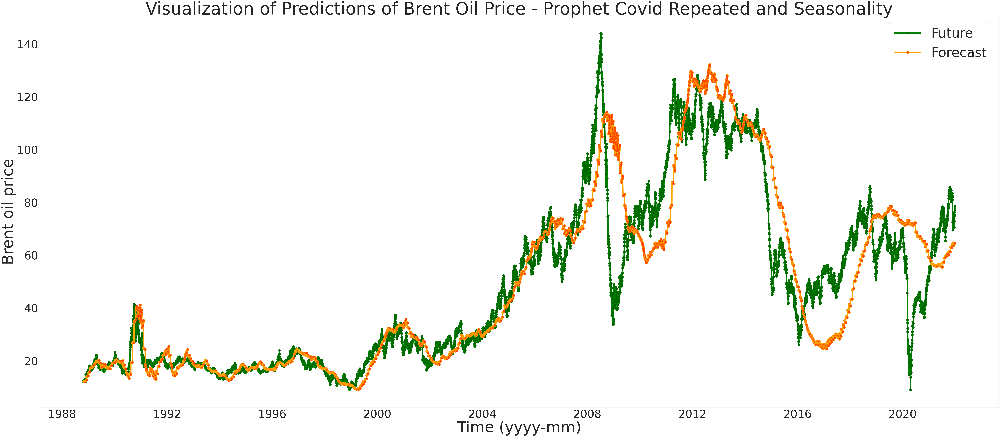

In [ ]:
# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(df_brent_cv_3['ds'],df_brent_cv_3['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(df_brent_cv_3['ds'],df_brent_cv_3['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


# plt.fill_between(df_cv['ds'], df_cv['yhat_lower'], df_cv['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('Brent oil price', fontsize= 75)
plt.title('Visualization of Predictions of Brent Oil Price - Prophet Covid Repeated and Seasonality', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)
# plt.savefig('forecast_future.png')

In [ ]:
brent_y_forecast_prophet_seasonality = m3_brent.predict(brent_y_future)
brent_y_forecast_prophet_seasonality[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].head()

,ds,yhat,yhat_lower,yhat_upper
0,2022-01-03,65.144888,54.007934,75.972765
1,2022-01-04,65.236588,53.604729,76.524124
2,2022-01-05,65.168266,54.193558,75.742898
3,2022-01-06,65.183054,53.944366,76.232545
4,2022-01-07,65.012036,52.994876,75.593588


In [ ]:
performance_metrics(df_brent_cv_3)

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,3 days,184.402317,13.579481,8.709677,0.179243,0.129227,0.168846,0.446260
1,4 days,192.222769,13.864443,8.799283,0.187288,0.124489,0.172658,0.451226
2,5 days,192.660801,13.880231,8.814383,0.189653,0.125737,0.174184,0.461054
3,6 days,193.769764,13.920121,8.909904,0.190868,0.125817,0.175987,0.454017
4,7 days,195.716451,13.989870,8.973832,0.192154,0.125594,0.176555,0.441415
5,8 days,194.376647,13.941903,8.913097,0.187133,0.129535,0.174260,0.441468
6,9 days,193.553783,13.912361,8.947183,0.182905,0.122708,0.174310,0.442791
7,10 days,196.222576,14.007947,9.067692,0.184540,0.134005,0.176406,0.443064
8,11 days,198.635673,14.093817,9.102872,0.187173,0.130840,0.178248,0.438917
9,12 days,203.587149,14.268397,9.198286,0.192603,0.130628,0.181154,0.428027


In [ ]:
performance_metrics(df_brent_cv_3).to_csv('/content/drive/MyDrive/PCDS_OilPricePrediction/forecasting_products/Prophet/Brent/Metrics_CovidRepeatedHoliday.csv')

(array([18993., 19052., 19113., 19174., 19236., 19297., 19358., 19417.]),
 [Text(18993.0, 0, '2022-01'),
  Text(19052.0, 0, '2022-03'),
  Text(19113.0, 0, '2022-05'),
  Text(19174.0, 0, '2022-07'),
  Text(19236.0, 0, '2022-09'),
  Text(19297.0, 0, '2022-11'),
  Text(19358.0, 0, '2023-01'),
  Text(19417.0, 0, '2023-03')])

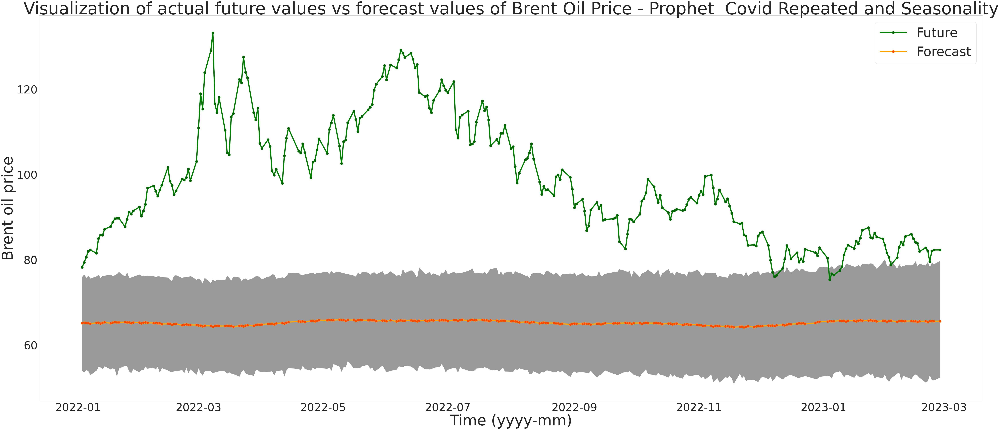

In [ ]:
# Visualisation of future value (development data) vs forecast value
fig = plt.figure(figsize=(85,35))
ax = fig.add_subplot()

plt.plot(brent_y_future['ds'],brent_y_future['y'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'darkgreen',
         marker='.',
        color='green',label='Future')

plt.plot(brent_y_future['ds'],brent_y_forecast_prophet_seasonality['yhat'],    
         markersize=25,linewidth=6,
         markerfacecolor= 'orangered',
         marker='.',
        color='orange',label='Forecast')


plt.fill_between(brent_y_future['ds'], brent_y_forecast_prophet_seasonality['yhat_lower'], brent_y_forecast_prophet_seasonality['yhat_upper'],color=(0.6,0.6,0.6))
plt.legend(fontsize=65)
plt.grid()
plt.xlabel('Time (yyyy-mm)', fontsize= 75)
plt.ylabel('Brent oil price', fontsize= 75)
plt.title('Visualization of actual future values vs forecast values of Brent Oil Price - Prophet  Covid Repeated and Seasonality', fontsize=85)
plt.yticks(fontsize=55)
plt.xticks(fontsize=55)
# plt.savefig('forecast_future.png')

# Results:

Based on all the three models we built we find that although all three models very comparable, to choose one for presentation, the third model with COVID adn manual yearly seasonality presents intself with the least CV MSE and RMSE as shown in the performance metrics of each model while making the fore cast.

It is to be noted that the CV plot although depits the preditins till the end of the models are trained on the training data only to avoid any data leakage. 

All the three prophet models that we have buil have surpassed the performace of the baseline model by reducing the chose error metric below that of the baseline model.

ALthough based upon the literature survey and the visualization FB prophet alone does seem to be accurately predicting the price its unique features could be utilized during an ensmble modeling phase. 


•The MSE and RMSE of the forecast period was evaluated to be  236.03 , 15.36  and 210.86, 14.52   for EU Brent and US Cushing crude oil Respectively. 

•This model was selected out of the three models built using Meta prophet including a 1. default model, 2. Covid event inclusive model and 3. covid inclusive manual yearly seasonality model. The third model with manual yearly seasonality including the covid yielded the least validation MSE and RMSE, although all the three model are quite comparable. 

•These results represent the best model (model 3) forecast among the various models built iteratively using FB/Meta Prophet for both EU Brent and US Cushing crude oil price data. 

•Hence, we can conclude that the although the model is performing better than the baseline model there is need to improve the model to make predictions more comparable to the actual values of the crude oil price of the EU Brent and US Cushing type. 